# CLIP (Constrasitive Language and Image Pre-trained model) test

In [4]:
# https://github.com/openai/CLIP

In [5]:
#Check CUDA and torch version
import subprocess

CUDA_version = [s for s in subprocess.check_output(["nvcc", "--version"]).decode("UTF-8").split(", ") if s.startswith("release")][0].split(" ")[-1]
print("CUDA version:", CUDA_version)
""""
if CUDA_version == "10.0":
    torch_version_suffix = "+cu100"
elif CUDA_version == "10.1":
    torch_version_suffix = "+cu101"
elif CUDA_version == "10.2":
    torch_version_suffix = ""
else:
    torch_version_suffix = "+cu110"

#!pip install torch==1.7.1{torch_version_suffix} torchvision==0.8.2{torch_version_suffix} -f https://download.pytorch.org/whl/torch_stable.html ftfy regex
"""
import numpy as np
import torch
import os

print("Torch version:", torch.__version__)
#os.kill(os.getpid(), 9)


CUDA version: 10.2
Torch version: 1.8.0


## Improve accuracy with Image Embedding + Text Embedding

['7874222803-sugar', '4157005670-almondmilk', '8491201426-HoneyBunch', '8113118392-tussin', '8113106123-tussin_max', '7874212406-sweetner', '1015803449-Cleanser', '4400004575-RitzCracker', '3600041777-Wipes', '41331112406-Beans', '1411391254-Pistachios', '8616220043-water', '7203002209-littleBite', '4000055113-m&mMilk', '1800012323-miniBiscuits', '4000051121-m&mPeanut', '3528244925-toyPenguin', '1920089962-SurfaceCleaner', '1600017819-berryCereal', '5000015991-evaporatedMilk', '7314115315-oreoPocky', '7232075003-pandaCookie', '787423717-taco', '4300020056-limeJello', '4300020053-cherryJello', '1370037299-Ziplock', '4288742634-dishwasherCleaner', '000000-lemon', '6416410193-BlueBerryBun', '84576204143-galaApple', '800016643095-Chips', '9413844-FujiApple', '11111-Egg']
['Great Value Pure Granulated Sugar 4 lb', 'Blue Diamond Almond Breeze milk Unsweetened Original Almond Milk, Half Gallon, 64 fl oz', 'Honey Bunches of Oats Honey Roasted Heart Healthy Low Fat made with Whole Grain Cereal,

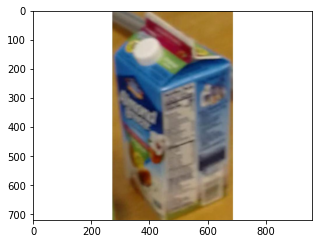

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.73


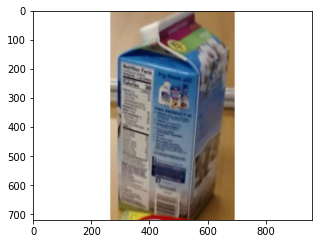

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.884


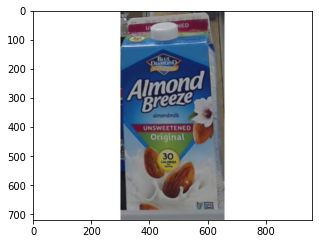

4157005670-almondmilk :   predicted as  4157005670-almondmilk 0.9995


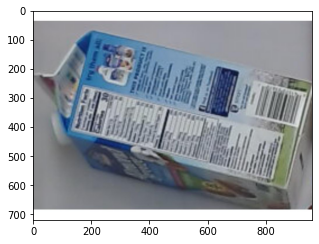

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.801


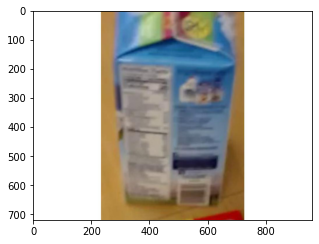

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.926


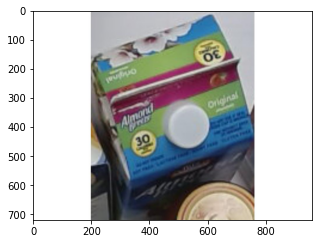

4157005670-almondmilk :   predicted as  7203002209-littleBite 0.2566


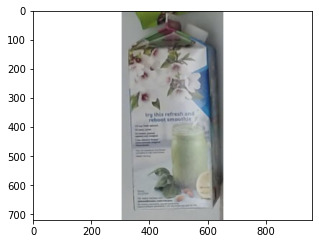

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.9634


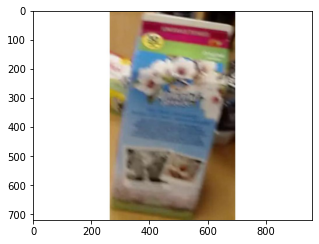

4157005670-almondmilk :   predicted as  1800012323-miniBiscuits 0.427


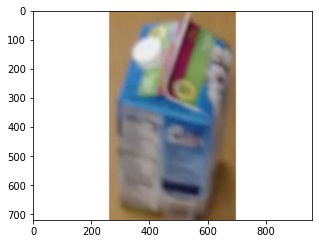

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.955


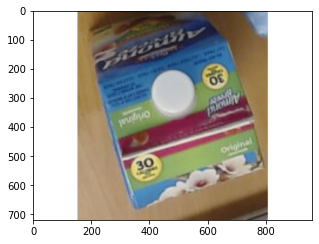

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.7935


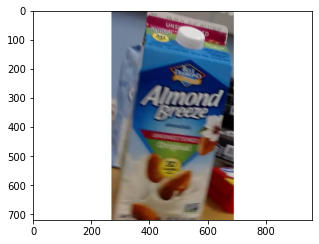

4157005670-almondmilk :   predicted as  4157005670-almondmilk 0.9966


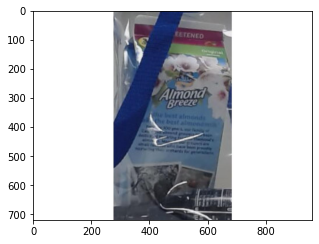

4157005670-almondmilk :   predicted as  4157005670-almondmilk 0.2917


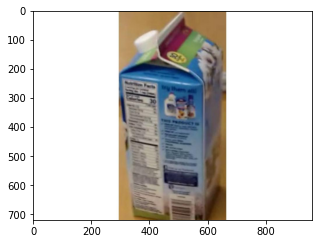

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.913


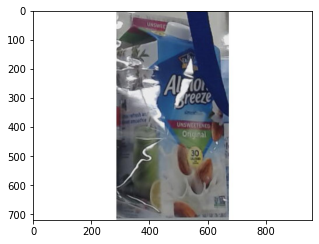

4157005670-almondmilk :   predicted as  4157005670-almondmilk 0.996


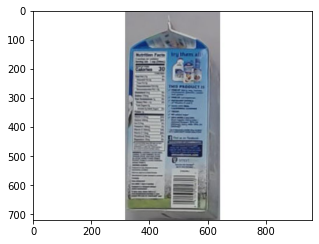

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.339


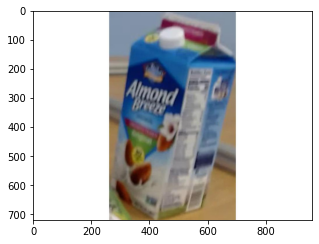

4157005670-almondmilk :   predicted as  4157005670-almondmilk 0.9927


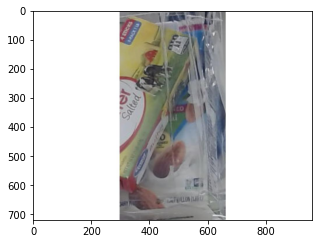

4157005670-almondmilk :   predicted as  1370037299-Ziplock 0.408


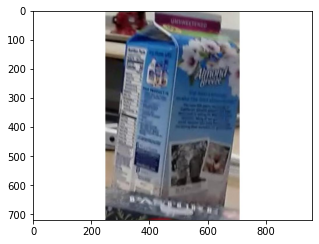

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.519


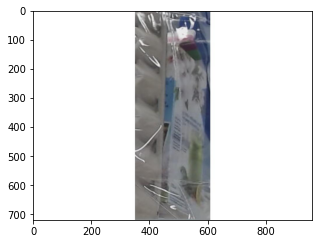

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.4504


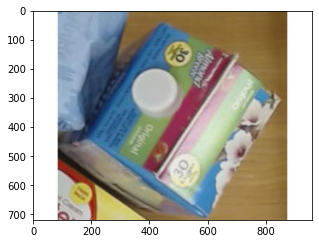

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.4802


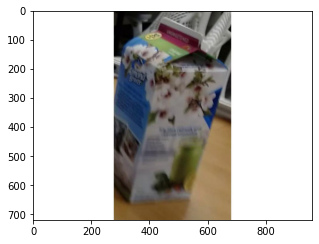

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.602


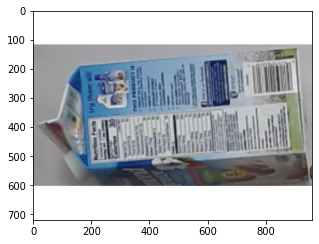

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.4998


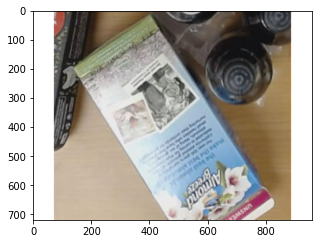

4157005670-almondmilk :   predicted as  7874212406-sweetner 0.3413


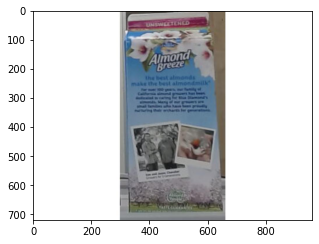

4157005670-almondmilk :   predicted as  4157005670-almondmilk 0.8804


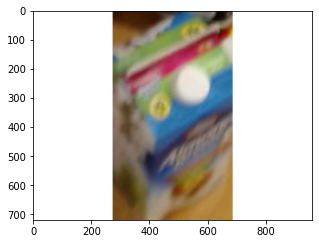

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.553


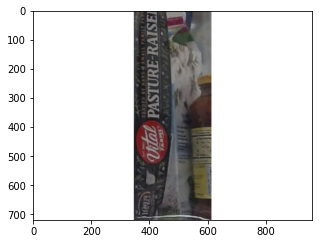

4157005670-almondmilk :   predicted as  1370037299-Ziplock 0.419


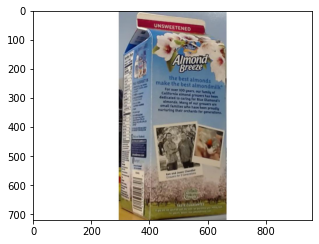

4157005670-almondmilk :   predicted as  4157005670-almondmilk 0.962


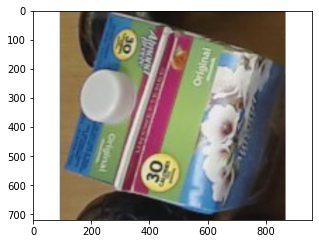

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.8604


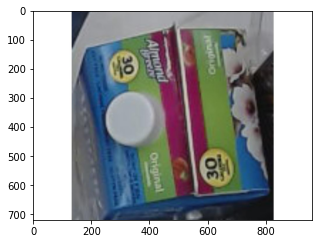

4157005670-almondmilk :   predicted as  1800012323-miniBiscuits 0.3557


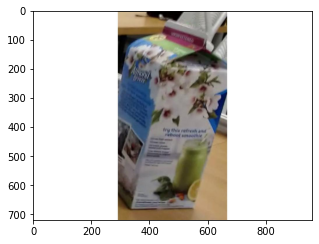

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.5522


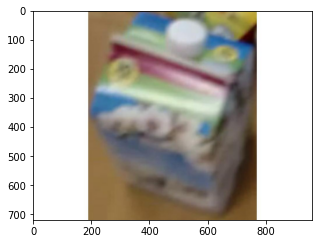

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.5293


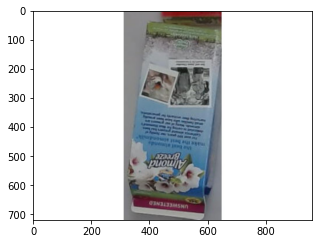

4157005670-almondmilk :   predicted as  7203002209-littleBite 0.4666


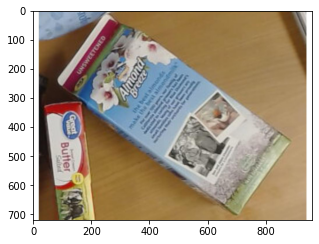

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.4985


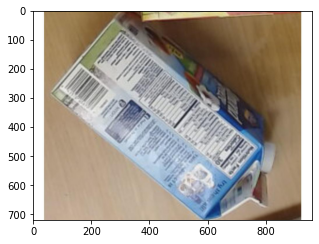

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.969


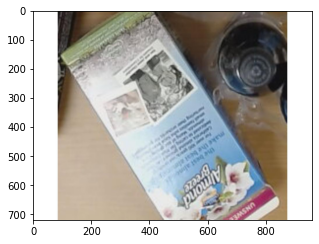

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.4653


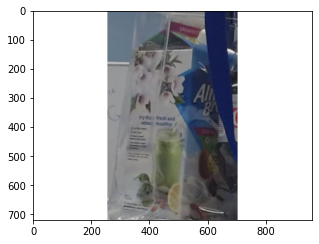

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.3613


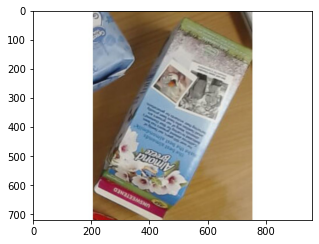

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.3704


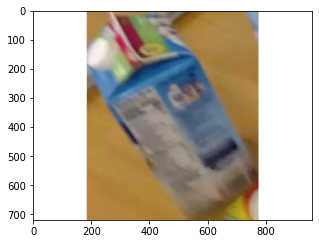

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.6562


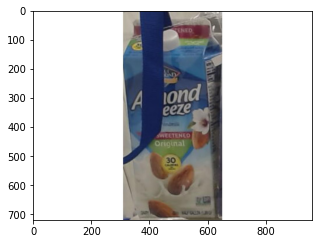

4157005670-almondmilk :   predicted as  4157005670-almondmilk 0.5835


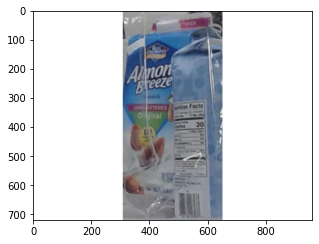

4157005670-almondmilk :   predicted as  4157005670-almondmilk 0.4656


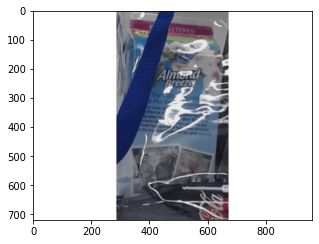

4157005670-almondmilk :   predicted as  4288742634-dishwasherCleaner 0.4016


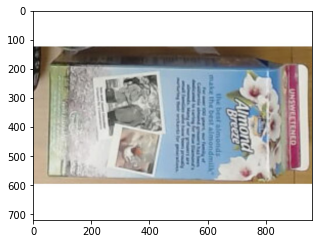

4157005670-almondmilk :   predicted as  4157005670-almondmilk 0.5396


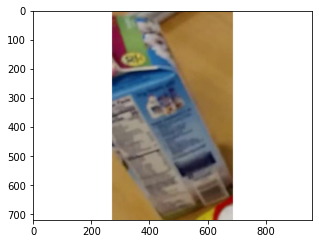

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.8574


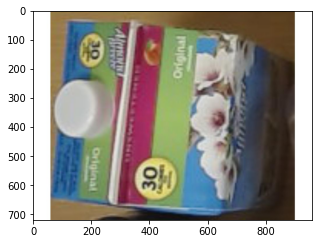

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.7944


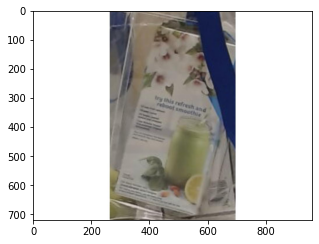

4157005670-almondmilk :   predicted as  84576204143-galaApple 0.2144


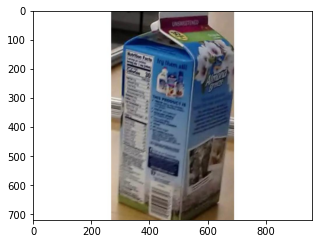

4157005670-almondmilk :   predicted as  4157005670-almondmilk 0.4907


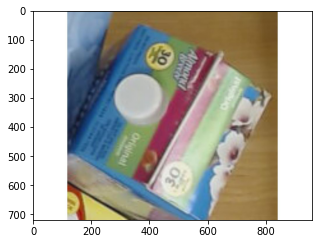

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.374


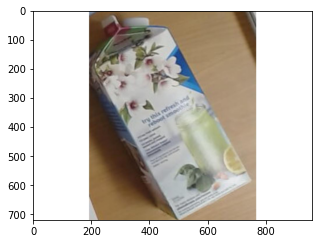

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.6436


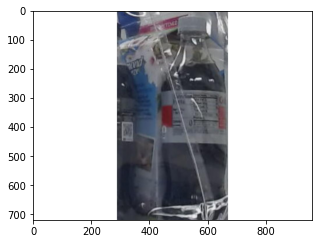

4157005670-almondmilk :   predicted as  84576204143-galaApple 0.32


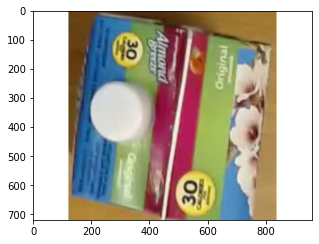

4157005670-almondmilk :   predicted as  3600041777-Wipes 0.6274


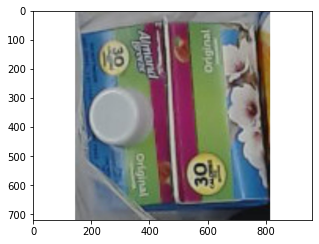

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.29


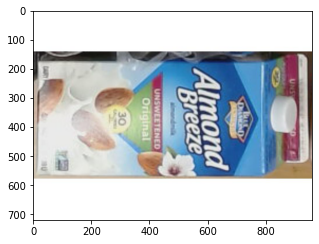

4157005670-almondmilk :   predicted as  1800012323-miniBiscuits 0.5366


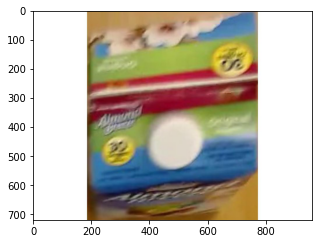

4157005670-almondmilk :   predicted as  3600041777-Wipes 0.719


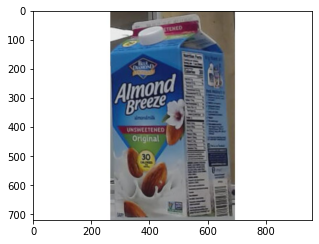

4157005670-almondmilk :   predicted as  4157005670-almondmilk 1.0


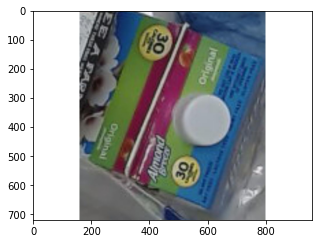

4157005670-almondmilk :   predicted as  3600041777-Wipes 0.838


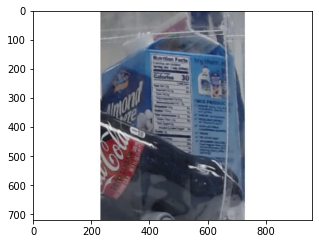

4157005670-almondmilk :   predicted as  1370037299-Ziplock 0.3535


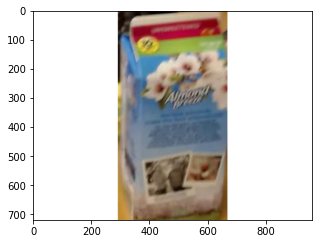

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.552


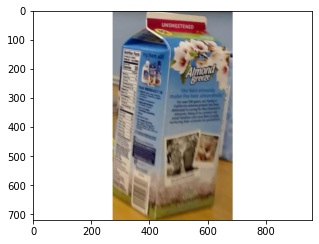

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.843


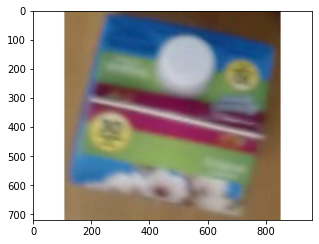

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.615


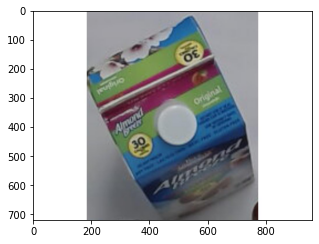

4157005670-almondmilk :   predicted as  3600041777-Wipes 0.5483


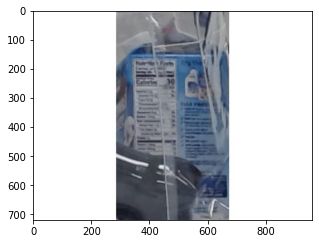

4157005670-almondmilk :   predicted as  1370037299-Ziplock 0.3772


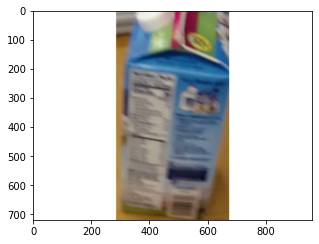

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.923


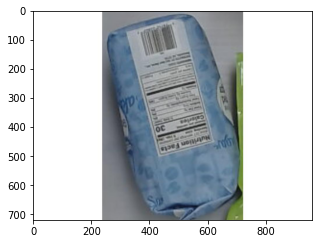

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.2773


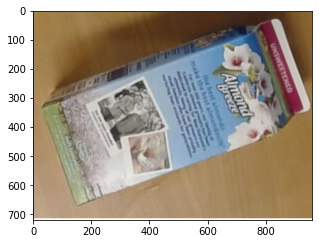

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.6997


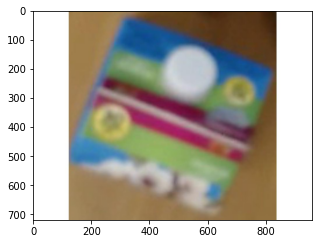

4157005670-almondmilk :   predicted as  3600041777-Wipes 0.6963


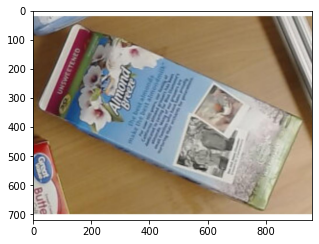

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.755


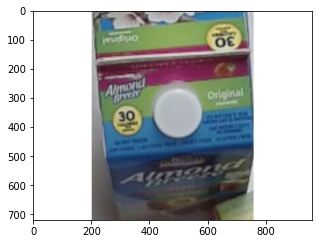

4157005670-almondmilk :   predicted as  3600041777-Wipes 0.386


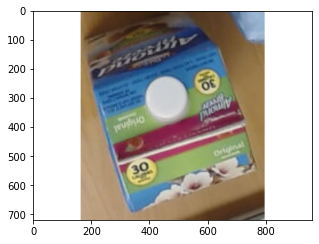

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.715


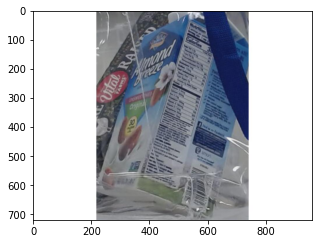

4157005670-almondmilk :   predicted as  1370037299-Ziplock 0.828


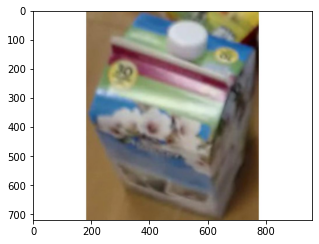

4157005670-almondmilk :   predicted as  7203002209-littleBite 0.629


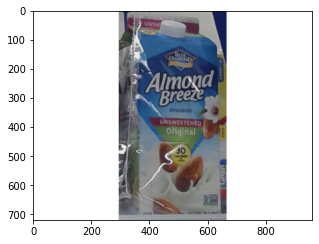

4157005670-almondmilk :   predicted as  4157005670-almondmilk 0.996


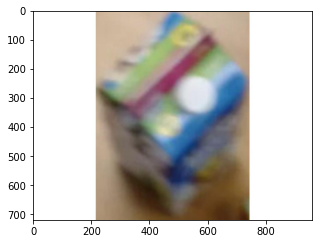

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.5635


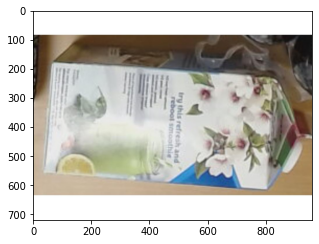

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.2803


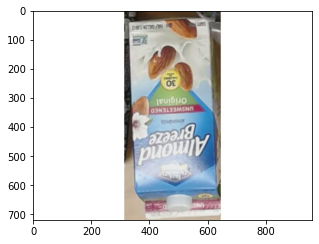

4157005670-almondmilk :   predicted as  1800012323-miniBiscuits 0.716


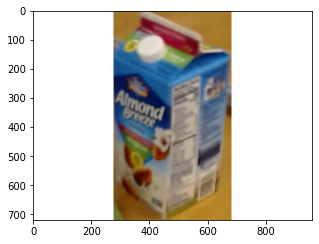

4157005670-almondmilk :   predicted as  4157005670-almondmilk 0.8525


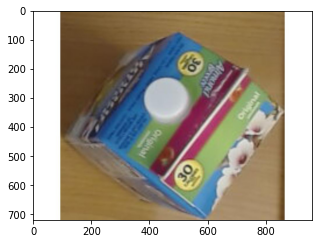

4157005670-almondmilk :   predicted as  7874222803-sugar 0.2325


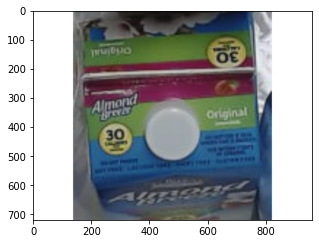

4157005670-almondmilk :   predicted as  3600041777-Wipes 0.7397


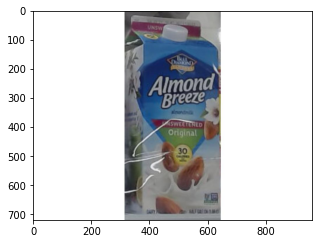

4157005670-almondmilk :   predicted as  4157005670-almondmilk 1.0


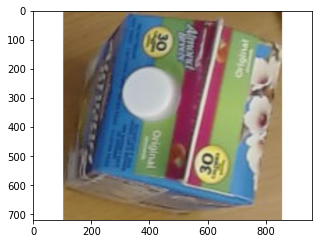

4157005670-almondmilk :   predicted as  7874222803-sugar 0.2312


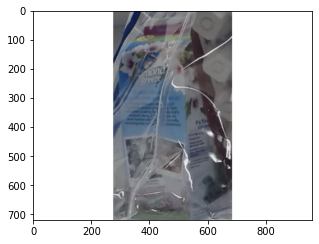

4157005670-almondmilk :   predicted as  7203002209-littleBite 0.312


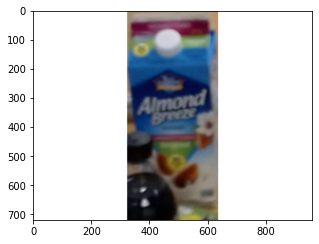

4157005670-almondmilk :   predicted as  4157005670-almondmilk 0.9976


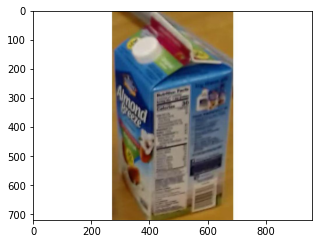

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.8


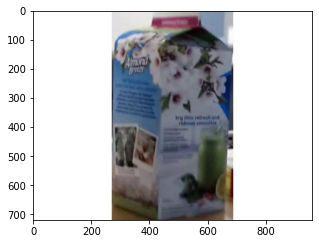

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.7266


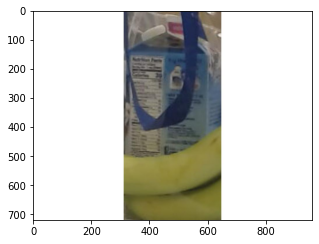

4157005670-almondmilk :   predicted as  84576204143-galaApple 0.519


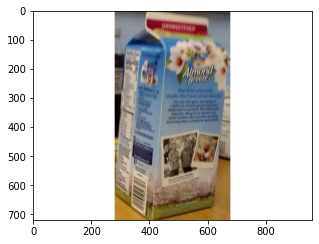

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.8813


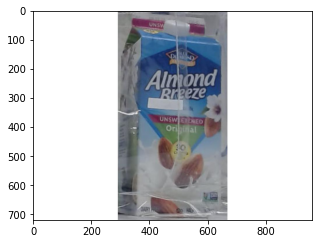

4157005670-almondmilk :   predicted as  4157005670-almondmilk 0.998


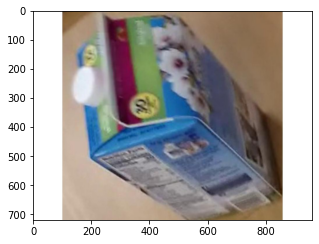

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.4983


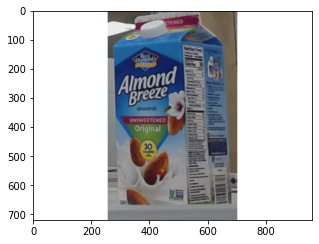

4157005670-almondmilk :   predicted as  4157005670-almondmilk 1.0


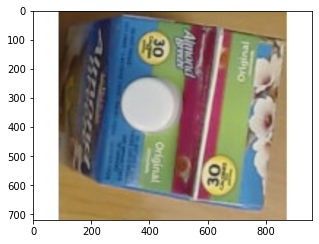

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.561


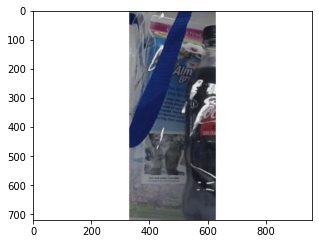

4157005670-almondmilk :   predicted as  4288742634-dishwasherCleaner 0.6


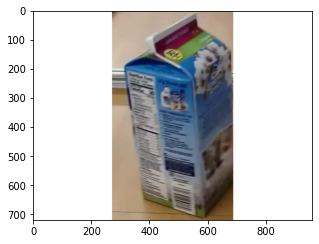

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.885


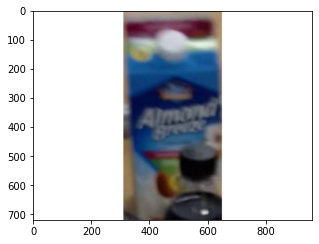

4157005670-almondmilk :   predicted as  4157005670-almondmilk 0.9927


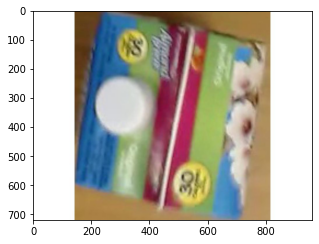

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.703


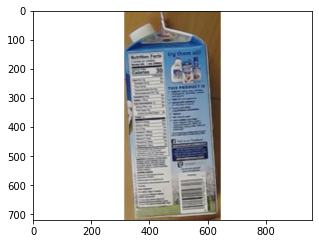

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.675


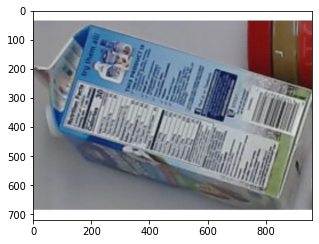

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.7524


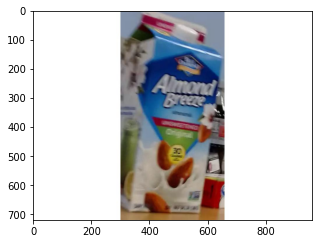

4157005670-almondmilk :   predicted as  4157005670-almondmilk 0.8765


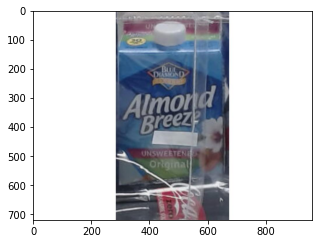

4157005670-almondmilk :   predicted as  4157005670-almondmilk 0.9946


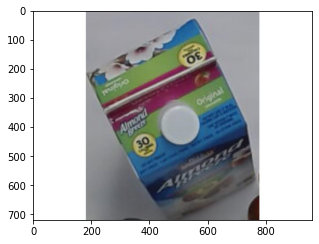

4157005670-almondmilk :   predicted as  3600041777-Wipes 0.348


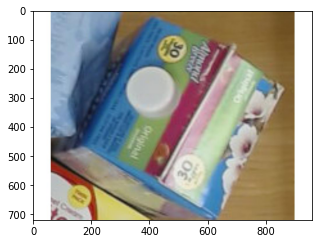

4157005670-almondmilk :   predicted as  7203002209-littleBite 0.388


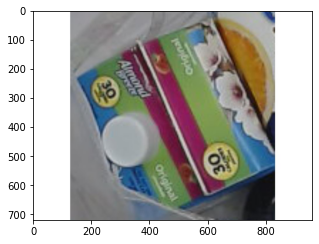

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.629


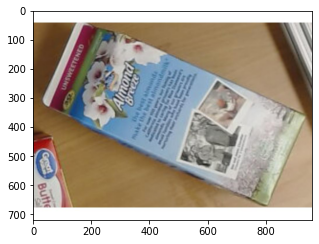

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.711


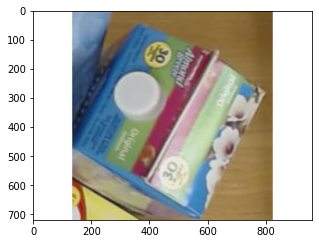

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.4163


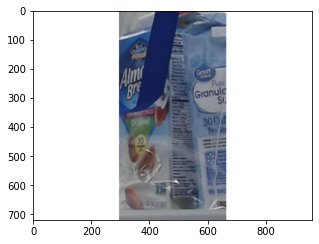

4157005670-almondmilk :   predicted as  1800012323-miniBiscuits 0.2083


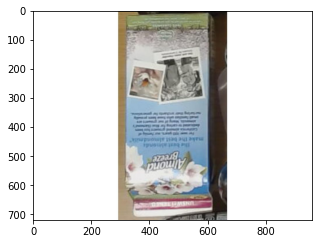

4157005670-almondmilk :   predicted as  7203002209-littleBite 0.618


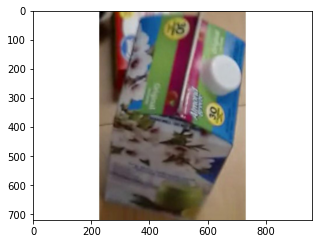

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.9326


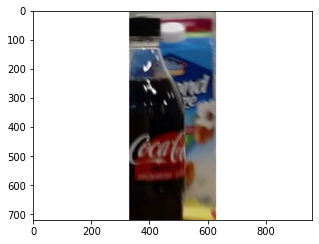

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.7817


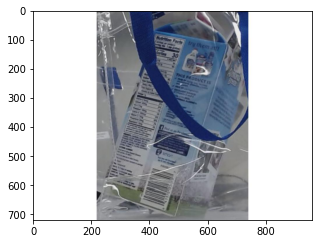

4157005670-almondmilk :   predicted as  7203002209-littleBite 0.193


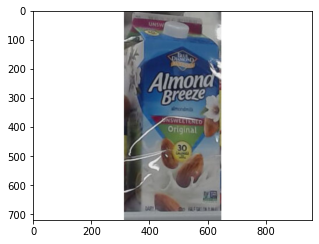

4157005670-almondmilk :   predicted as  4157005670-almondmilk 0.901


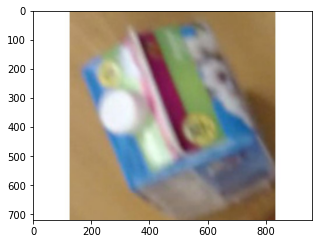

4157005670-almondmilk :   predicted as  3600041777-Wipes 0.3147


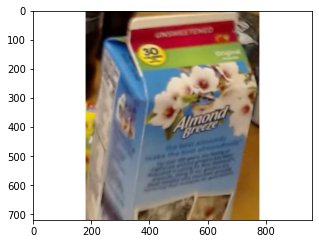

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.9414


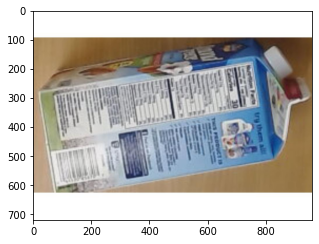

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.4905


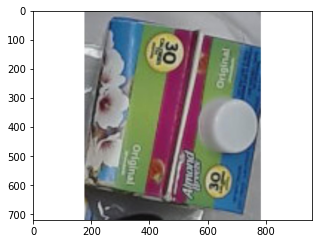

4157005670-almondmilk :   predicted as  3600041777-Wipes 0.4485


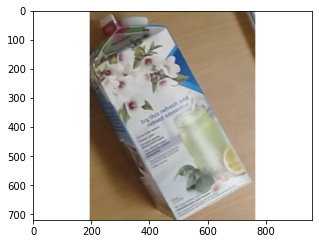

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.808


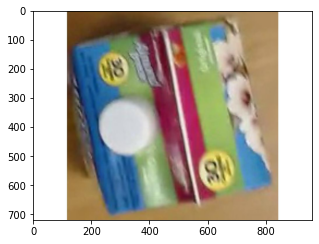

4157005670-almondmilk :   predicted as  7203002209-littleBite 0.4878


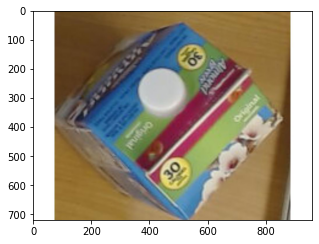

4157005670-almondmilk :   predicted as  7203002209-littleBite 0.3757


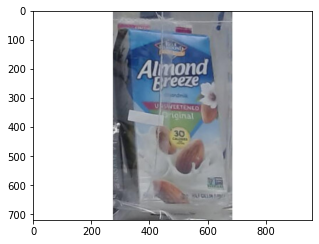

4157005670-almondmilk :   predicted as  4157005670-almondmilk 0.9995


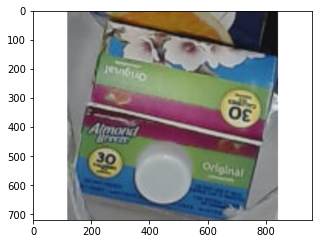

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.402


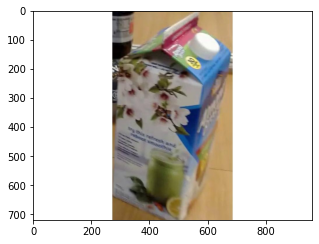

4157005670-almondmilk :   predicted as  9413844-FujiApple 0.4578


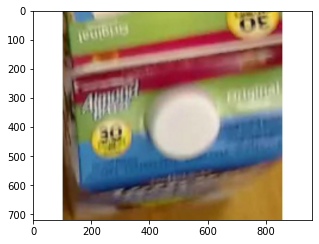

4157005670-almondmilk :   predicted as  3600041777-Wipes 0.721


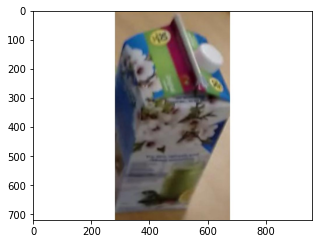

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.513


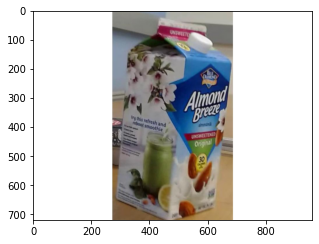

4157005670-almondmilk :   predicted as  4157005670-almondmilk 0.992


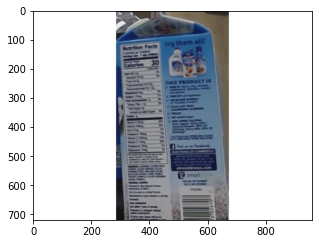

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.4504


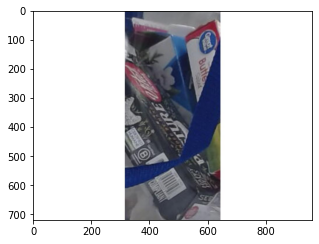

4157005670-almondmilk :   predicted as  4288742634-dishwasherCleaner 0.3127


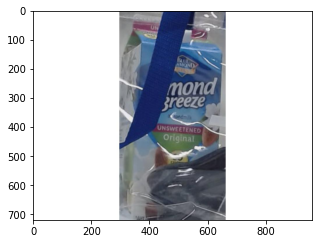

4157005670-almondmilk :   predicted as  1370037299-Ziplock 0.6533


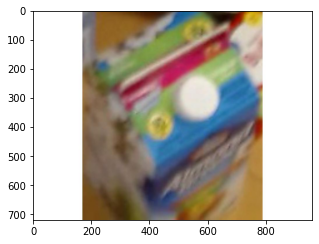

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.4475


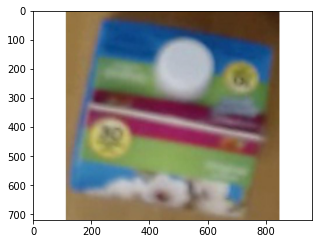

4157005670-almondmilk :   predicted as  3600041777-Wipes 0.4792


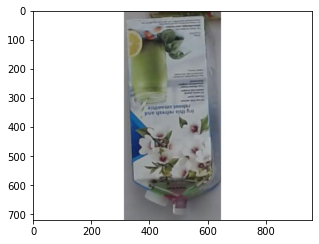

4157005670-almondmilk :   predicted as  1920089962-SurfaceCleaner 0.5903


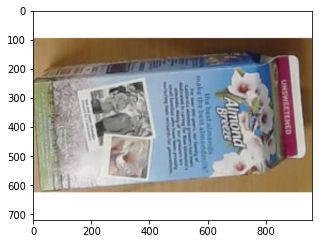

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.3682


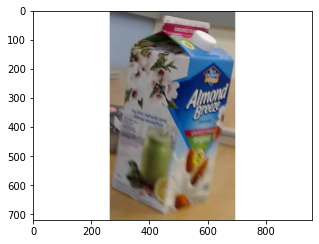

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.855


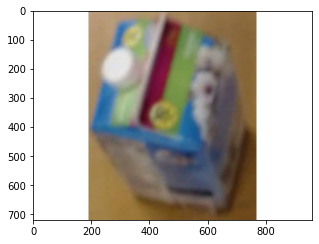

4157005670-almondmilk :   predicted as  7203002209-littleBite 0.4124


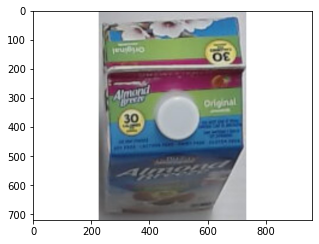

4157005670-almondmilk :   predicted as  4157005670-almondmilk 0.4243


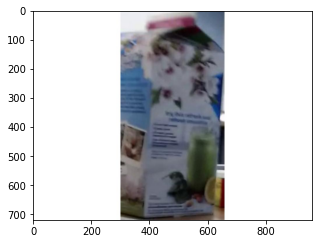

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.865


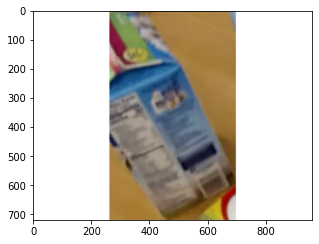

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.8574


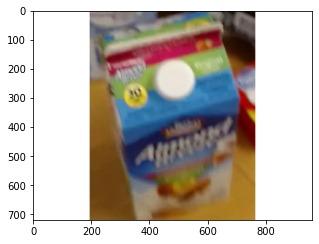

4157005670-almondmilk :   predicted as  4157005670-almondmilk 0.797


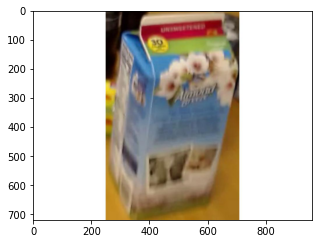

4157005670-almondmilk :   predicted as  1800012323-miniBiscuits 0.514


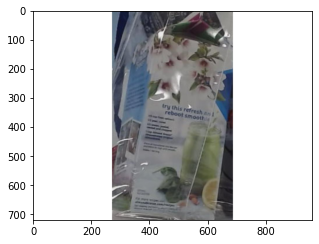

4157005670-almondmilk :   predicted as  1370037299-Ziplock 0.3564


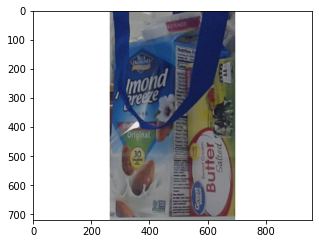

4157005670-almondmilk :   predicted as  7203002209-littleBite 0.5293


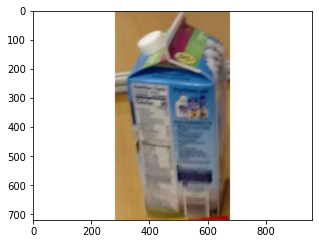

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.895


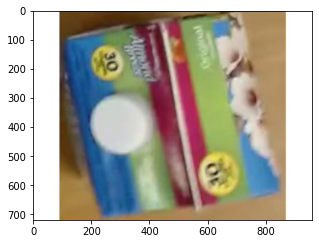

4157005670-almondmilk :   predicted as  7203002209-littleBite 0.637


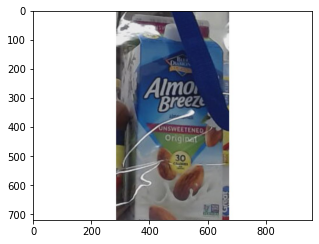

4157005670-almondmilk :   predicted as  4157005670-almondmilk 0.9736


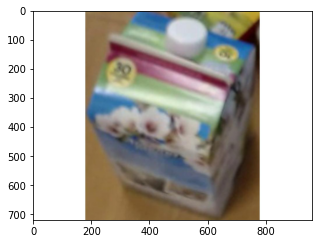

4157005670-almondmilk :   predicted as  7203002209-littleBite 0.4778


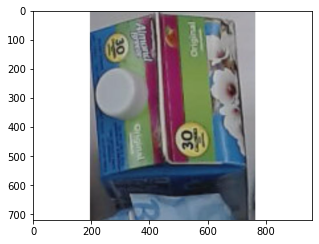

4157005670-almondmilk :   predicted as  1800012323-miniBiscuits 0.7173


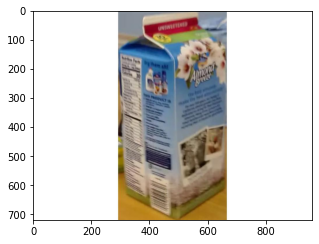

4157005670-almondmilk :   predicted as  1800012323-miniBiscuits 0.303


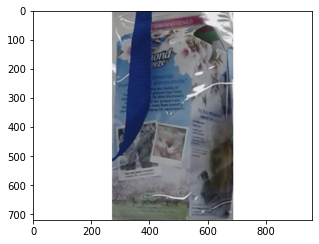

4157005670-almondmilk :   predicted as  7874222803-sugar 0.4055


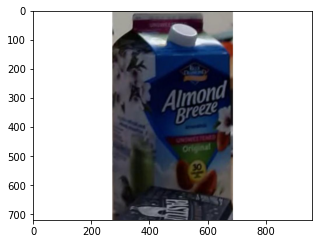

4157005670-almondmilk :   predicted as  4157005670-almondmilk 1.0


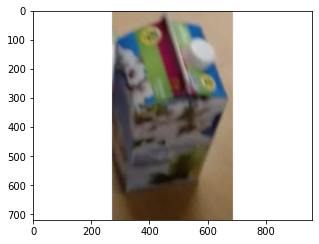

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.894


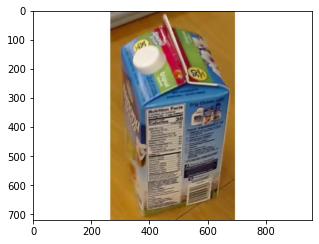

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.8467


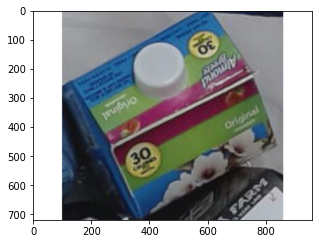

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.7324


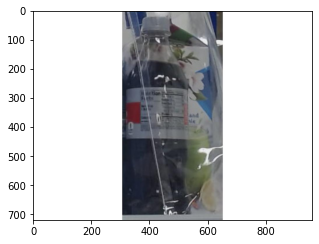

4157005670-almondmilk :   predicted as  5000015991-evaporatedMilk 0.67

accuracy on class 4157005670-almondmilk is :0.18791946308724833

no picture are found for 8491201426-HoneyBunch

no picture are found for 8113118392-tussin

no picture are found for 8113106123-tussin_max

no picture are found for 7874212406-sweetner

no picture are found for 1015803449-Cleanser

no picture are found for 4400004575-RitzCracker

no picture are found for 3600041777-Wipes

no picture are found for 41331112406-Beans

no picture are found for 1411391254-Pistachios

no picture are found for 8616220043-water

no picture are found for 7203002209-littleBite

no picture are found for 4000055113-m&mMilk

no picture are found for 1800012323-miniBiscuits

no picture are found for 4000051121-m&mPeanut

no picture are found for 3528244925-toyPenguin

no picture are found for 1920089962-SurfaceCleaner

no picture are found for 1600017819-berryCereal

no picture are found for 5000015991-evaporatedMilk

no picture ar

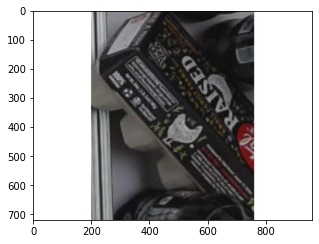

11111-Egg :   predicted as  4288742634-dishwasherCleaner 0.4436


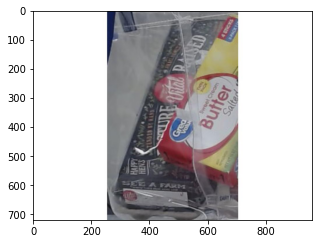

11111-Egg :   predicted as  1370037299-Ziplock 0.701


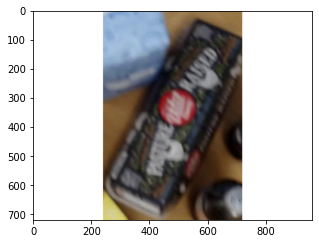

11111-Egg :   predicted as  5000015991-evaporatedMilk 0.3389


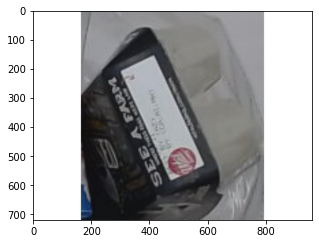

11111-Egg :   predicted as  84576204143-galaApple 0.31


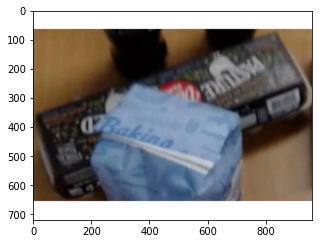

11111-Egg :   predicted as  84576204143-galaApple 0.2798


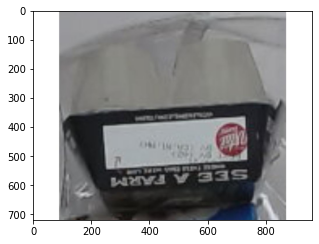

11111-Egg :   predicted as  7874212406-sweetner 0.274


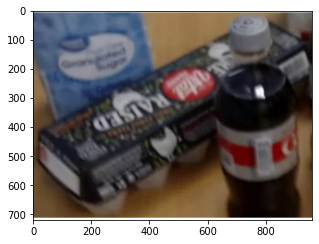

11111-Egg :   predicted as  4288742634-dishwasherCleaner 0.4956


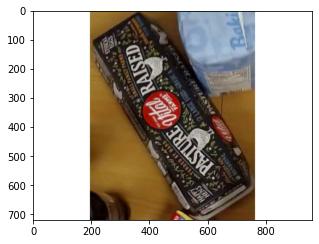

11111-Egg :   predicted as  7314115315-oreoPocky 0.662


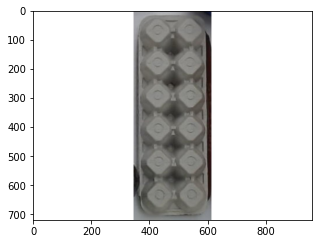

11111-Egg :   predicted as  1370037299-Ziplock 0.3088


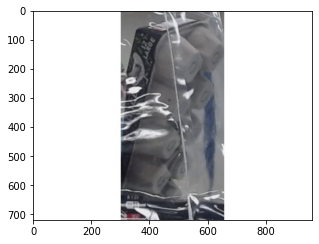

11111-Egg :   predicted as  84576204143-galaApple 0.519


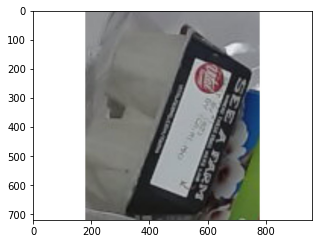

11111-Egg :   predicted as  5000015991-evaporatedMilk 0.4204


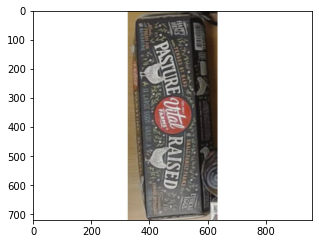

11111-Egg :   predicted as  4400004575-RitzCracker 0.314


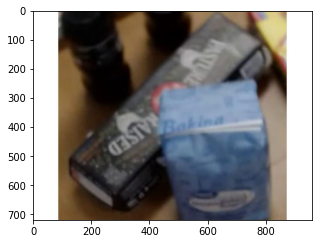

11111-Egg :   predicted as  4288742634-dishwasherCleaner 0.621


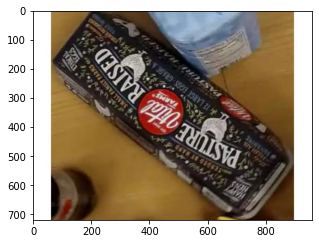

11111-Egg :   predicted as  5000015991-evaporatedMilk 0.6006


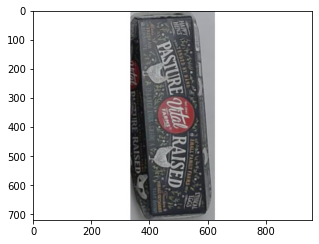

11111-Egg :   predicted as  7874212406-sweetner 0.4128


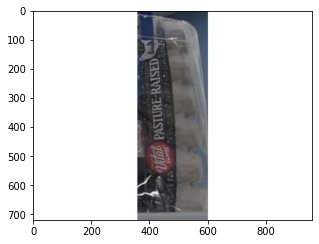

11111-Egg :   predicted as  6416410193-BlueBerryBun 0.562


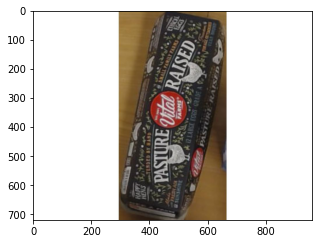

11111-Egg :   predicted as  7874212406-sweetner 0.3472


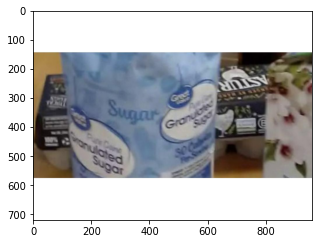

11111-Egg :   predicted as  7874222803-sugar 0.704


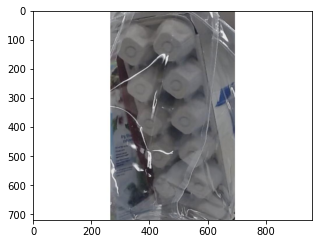

11111-Egg :   predicted as  7203002209-littleBite 0.4526


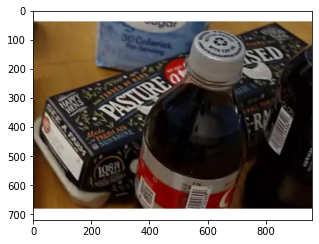

11111-Egg :   predicted as  4288742634-dishwasherCleaner 0.2491


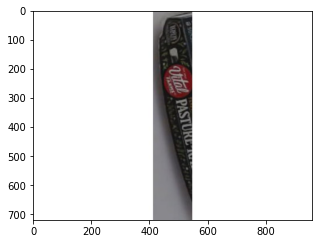

11111-Egg :   predicted as  7314115315-oreoPocky 0.292


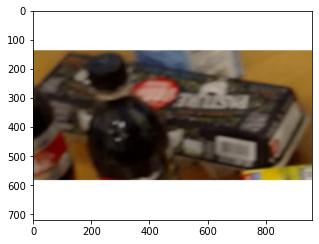

11111-Egg :   predicted as  4288742634-dishwasherCleaner 0.4978


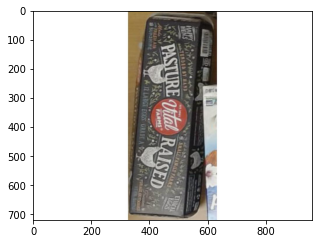

11111-Egg :   predicted as  4000055113-m&mMilk 0.299


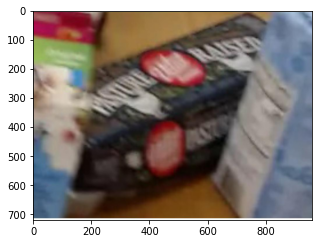

11111-Egg :   predicted as  5000015991-evaporatedMilk 0.3865


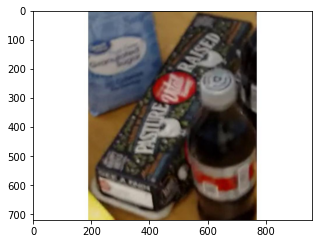

11111-Egg :   predicted as  5000015991-evaporatedMilk 0.7817


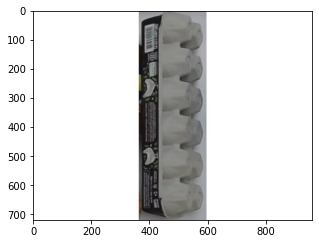

11111-Egg :   predicted as  7314115315-oreoPocky 0.405


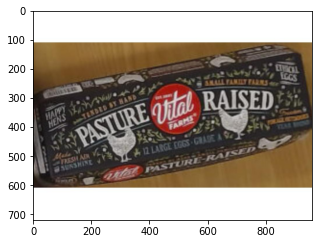

11111-Egg :   predicted as  11111-Egg 0.8164


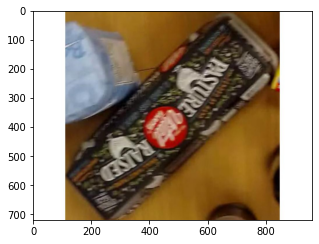

11111-Egg :   predicted as  5000015991-evaporatedMilk 0.559


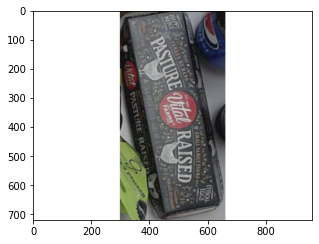

11111-Egg :   predicted as  7874212406-sweetner 0.574


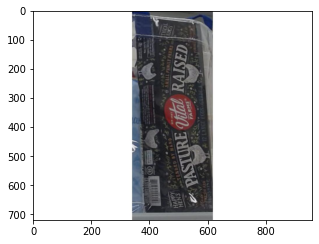

11111-Egg :   predicted as  1370037299-Ziplock 0.721


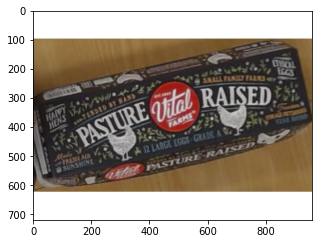

11111-Egg :   predicted as  11111-Egg 0.843


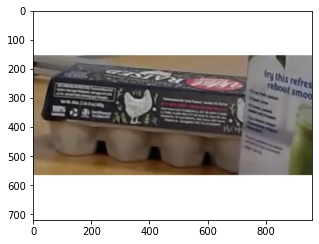

11111-Egg :   predicted as  4288742634-dishwasherCleaner 0.395


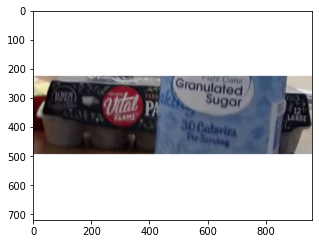

11111-Egg :   predicted as  7874222803-sugar 0.848


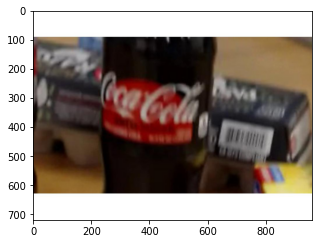

11111-Egg :   predicted as  7874212406-sweetner 0.4102


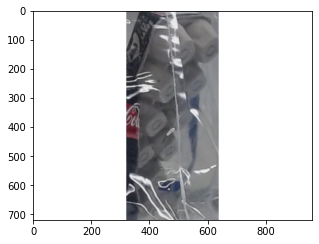

11111-Egg :   predicted as  1370037299-Ziplock 0.3542


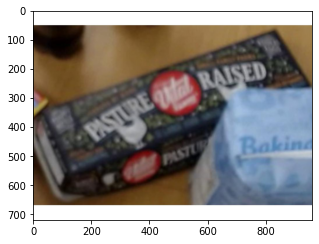

11111-Egg :   predicted as  5000015991-evaporatedMilk 0.4446


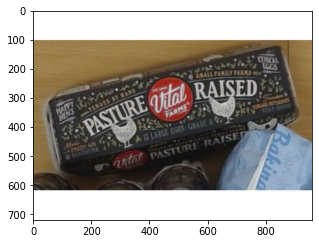

11111-Egg :   predicted as  5000015991-evaporatedMilk 0.3557


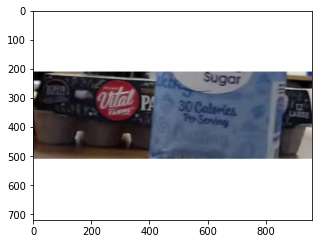

11111-Egg :   predicted as  7874222803-sugar 0.4583


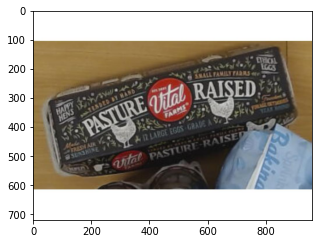

11111-Egg :   predicted as  11111-Egg 0.3271


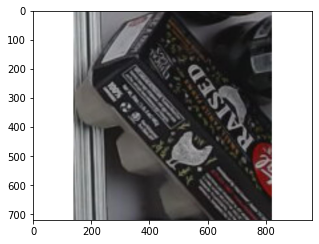

11111-Egg :   predicted as  7232075003-pandaCookie 0.3394


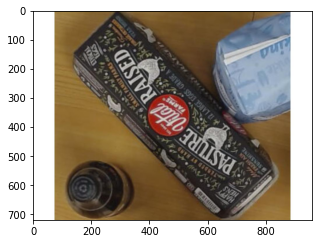

11111-Egg :   predicted as  5000015991-evaporatedMilk 0.435


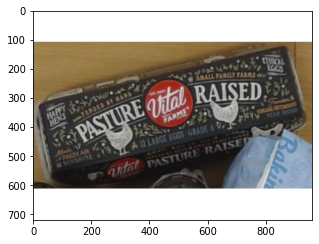

11111-Egg :   predicted as  11111-Egg 0.408


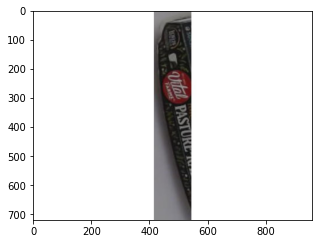

11111-Egg :   predicted as  7314115315-oreoPocky 0.2986


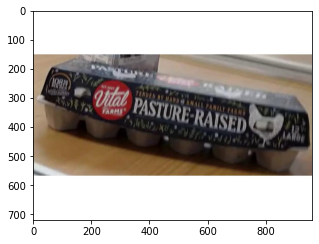

11111-Egg :   predicted as  11111-Egg 0.9375


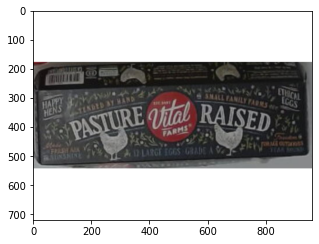

11111-Egg :   predicted as  11111-Egg 0.6357


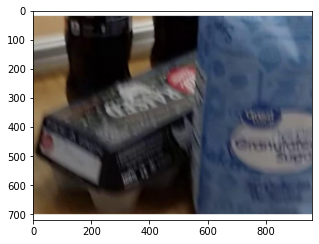

11111-Egg :   predicted as  5000015991-evaporatedMilk 0.5483


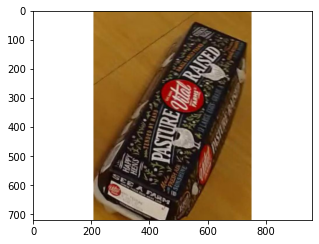

11111-Egg :   predicted as  7314115315-oreoPocky 0.4224


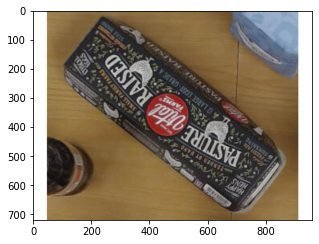

11111-Egg :   predicted as  5000015991-evaporatedMilk 0.7124


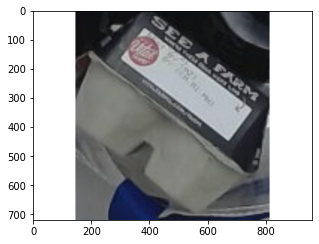

11111-Egg :   predicted as  7874222803-sugar 0.2605


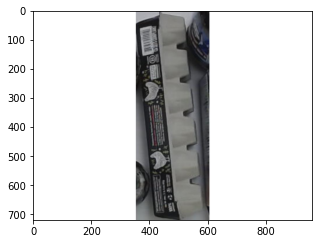

11111-Egg :   predicted as  4288742634-dishwasherCleaner 0.75


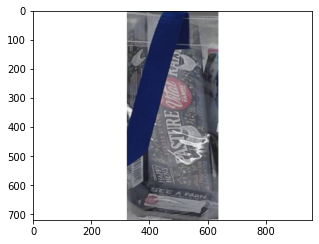

11111-Egg :   predicted as  1370037299-Ziplock 0.323


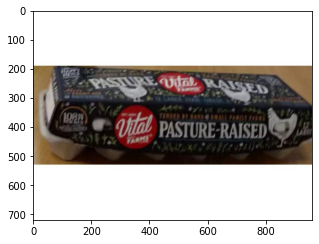

11111-Egg :   predicted as  11111-Egg 0.6294


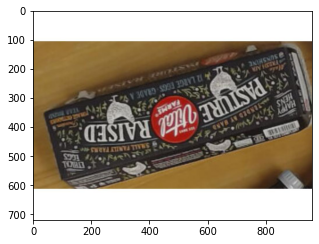

11111-Egg :   predicted as  7314115315-oreoPocky 0.4993


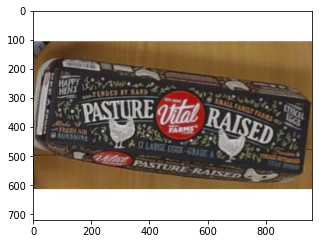

11111-Egg :   predicted as  11111-Egg 0.916


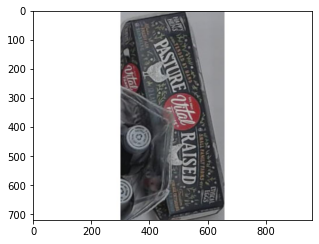

11111-Egg :   predicted as  7874212406-sweetner 0.287


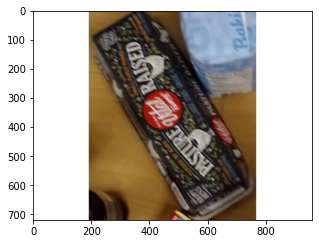

11111-Egg :   predicted as  5000015991-evaporatedMilk 0.3093


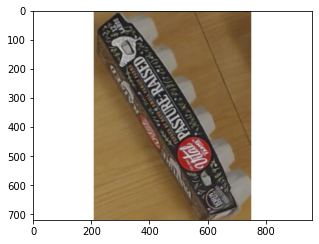

11111-Egg :   predicted as  800016643095-Chips 0.371


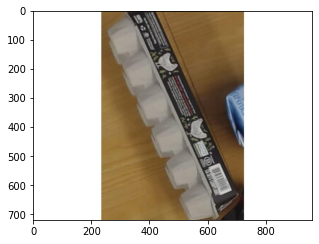

11111-Egg :   predicted as  4288742634-dishwasherCleaner 0.3928


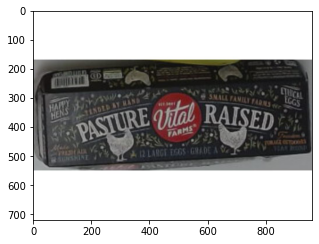

11111-Egg :   predicted as  11111-Egg 0.8237


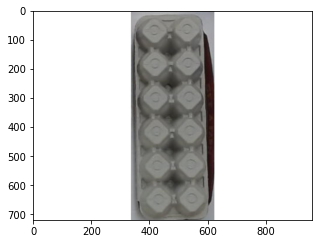

11111-Egg :   predicted as  1370037299-Ziplock 0.2986


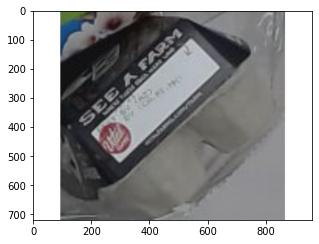

11111-Egg :   predicted as  84576204143-galaApple 0.2483


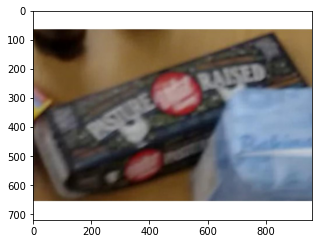

11111-Egg :   predicted as  1370037299-Ziplock 0.3042


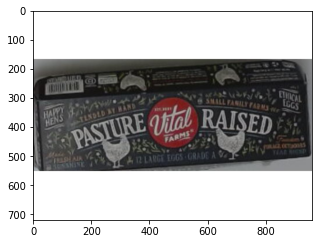

11111-Egg :   predicted as  11111-Egg 0.7407


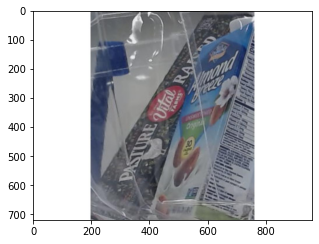

11111-Egg :   predicted as  5000015991-evaporatedMilk 0.5483


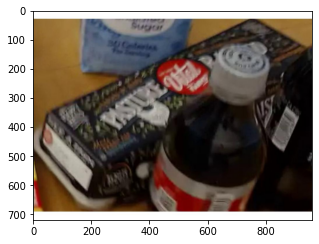

11111-Egg :   predicted as  5000015991-evaporatedMilk 0.75


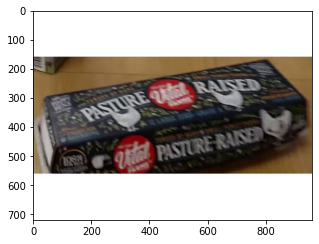

11111-Egg :   predicted as  11111-Egg 0.785


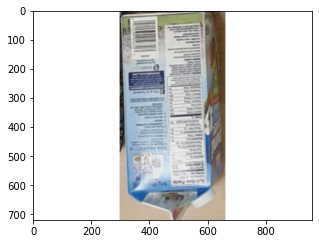

11111-Egg :   predicted as  5000015991-evaporatedMilk 0.7876


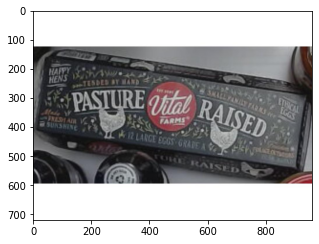

11111-Egg :   predicted as  11111-Egg 0.89


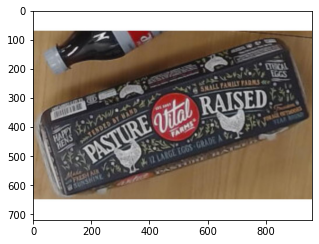

11111-Egg :   predicted as  5000015991-evaporatedMilk 0.556


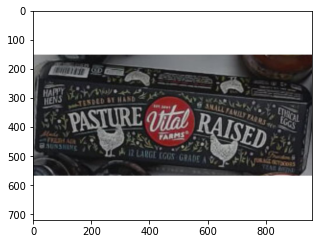

11111-Egg :   predicted as  11111-Egg 0.946


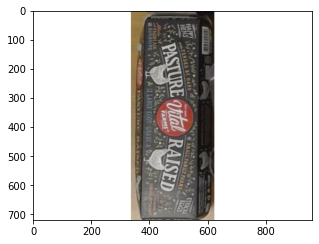

11111-Egg :   predicted as  7874212406-sweetner 0.3457


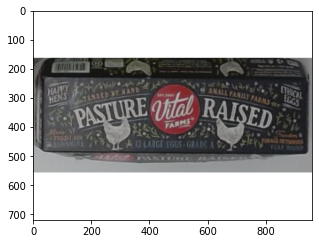

11111-Egg :   predicted as  11111-Egg 0.876


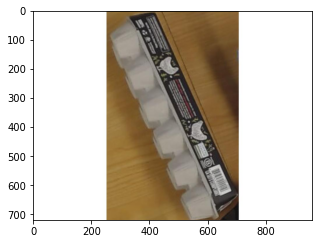

11111-Egg :   predicted as  7314115315-oreoPocky 0.5312


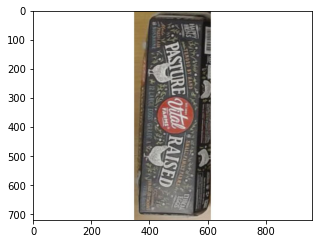

11111-Egg :   predicted as  7874212406-sweetner 0.2424


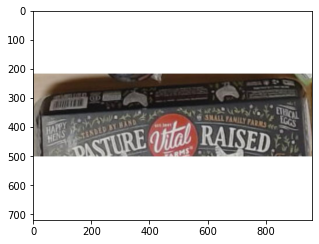

11111-Egg :   predicted as  11111-Egg 0.3582


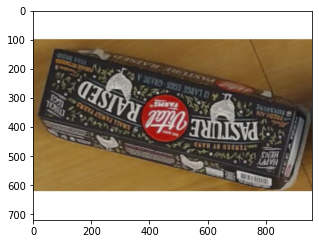

11111-Egg :   predicted as  5000015991-evaporatedMilk 0.58


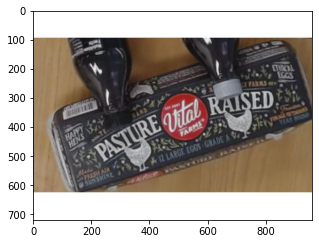

11111-Egg :   predicted as  5000015991-evaporatedMilk 0.5996


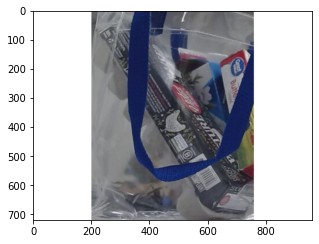

11111-Egg :   predicted as  7203002209-littleBite 0.4714


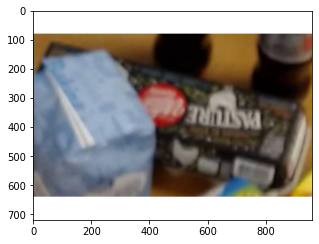

11111-Egg :   predicted as  5000015991-evaporatedMilk 0.3625


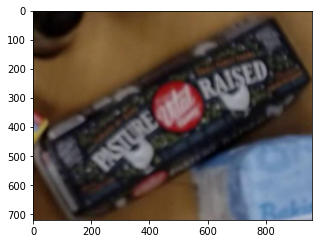

11111-Egg :   predicted as  5000015991-evaporatedMilk 0.7646


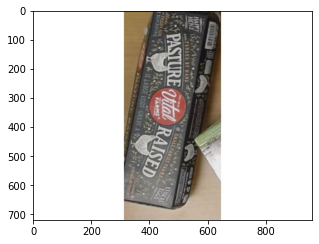

11111-Egg :   predicted as  7874212406-sweetner 0.2979


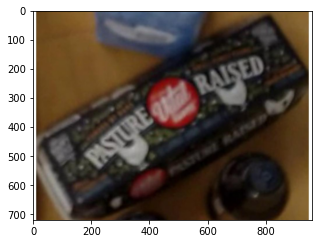

11111-Egg :   predicted as  5000015991-evaporatedMilk 0.49


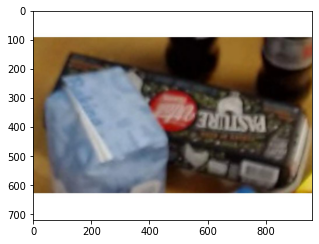

11111-Egg :   predicted as  5000015991-evaporatedMilk 0.432


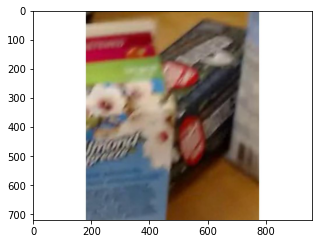

11111-Egg :   predicted as  5000015991-evaporatedMilk 0.7485


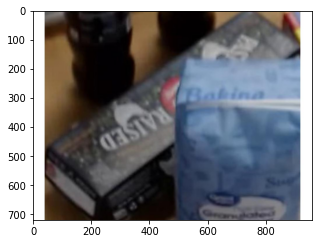

11111-Egg :   predicted as  5000015991-evaporatedMilk 0.737


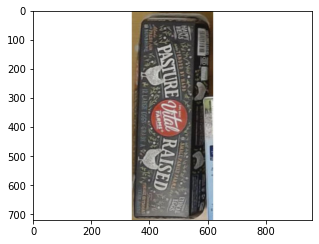

11111-Egg :   predicted as  4400004575-RitzCracker 0.4934


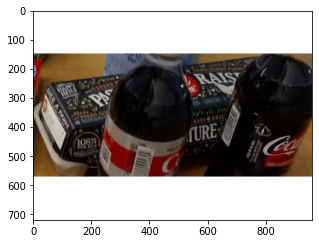

11111-Egg :   predicted as  5000015991-evaporatedMilk 0.329


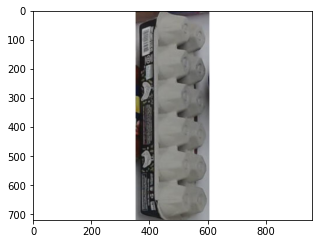

11111-Egg :   predicted as  6416410193-BlueBerryBun 0.6445


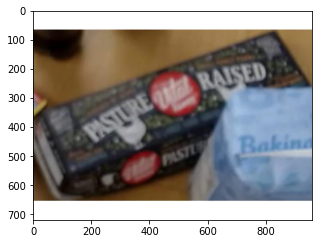

11111-Egg :   predicted as  5000015991-evaporatedMilk 0.3398


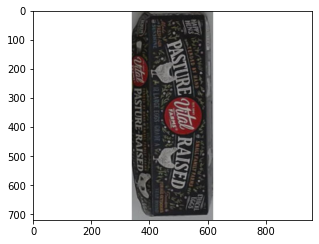

11111-Egg :   predicted as  7874212406-sweetner 0.4888


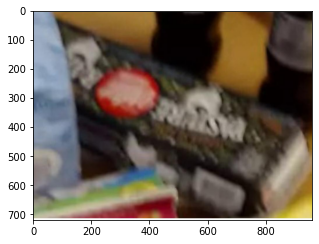

11111-Egg :   predicted as  9413844-FujiApple 0.2172


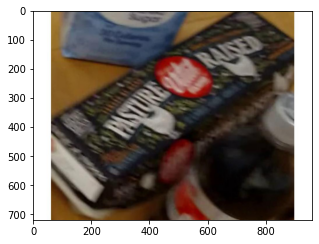

11111-Egg :   predicted as  5000015991-evaporatedMilk 0.5093


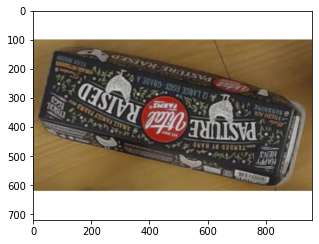

11111-Egg :   predicted as  5000015991-evaporatedMilk 0.3215


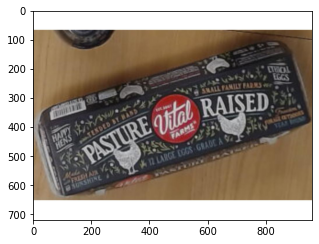

11111-Egg :   predicted as  5000015991-evaporatedMilk 0.6255


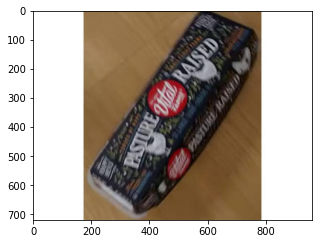

11111-Egg :   predicted as  5000015991-evaporatedMilk 0.3264


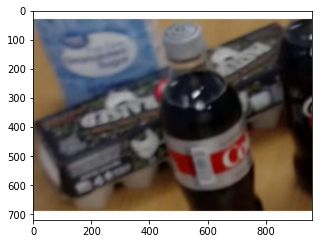

11111-Egg :   predicted as  5000015991-evaporatedMilk 0.806


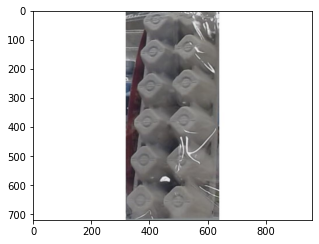

11111-Egg :   predicted as  1370037299-Ziplock 0.2369


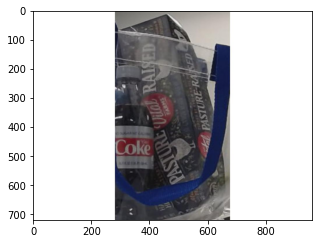

11111-Egg :   predicted as  7874212406-sweetner 0.4612


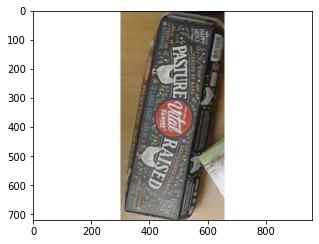

11111-Egg :   predicted as  4000055113-m&mMilk 0.2002


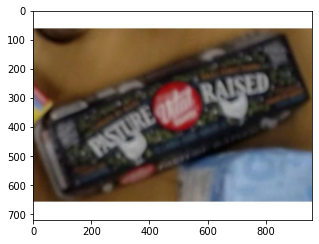

11111-Egg :   predicted as  5000015991-evaporatedMilk 0.292


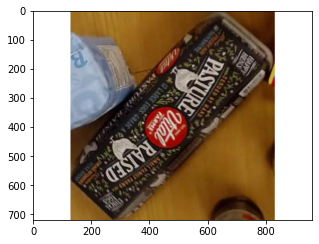

11111-Egg :   predicted as  4288742634-dishwasherCleaner 0.4324


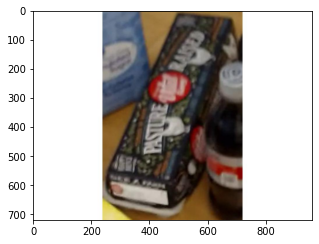

11111-Egg :   predicted as  5000015991-evaporatedMilk 0.456


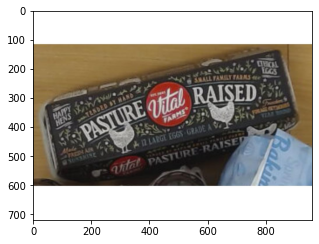

11111-Egg :   predicted as  11111-Egg 0.3823


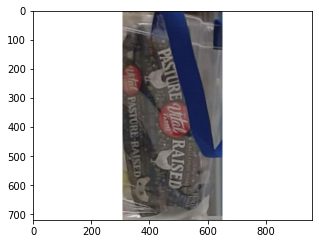

11111-Egg :   predicted as  1370037299-Ziplock 0.3464


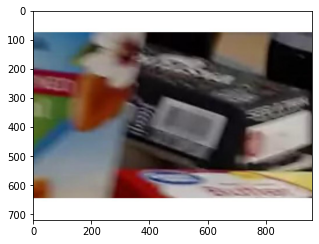

11111-Egg :   predicted as  4288742634-dishwasherCleaner 0.624


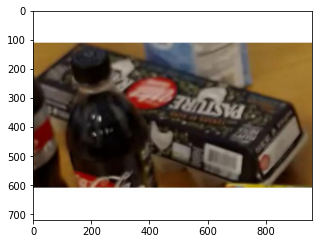

11111-Egg :   predicted as  5000015991-evaporatedMilk 0.9263


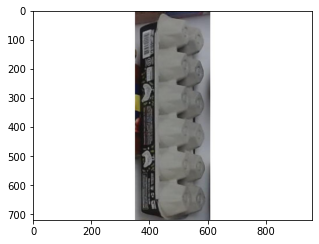

11111-Egg :   predicted as  1370037299-Ziplock 0.317


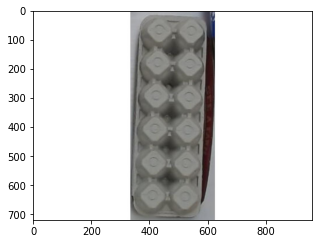

11111-Egg :   predicted as  6416410193-BlueBerryBun 0.1603


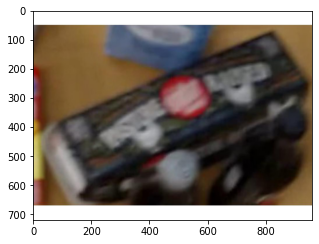

11111-Egg :   predicted as  4288742634-dishwasherCleaner 0.4822


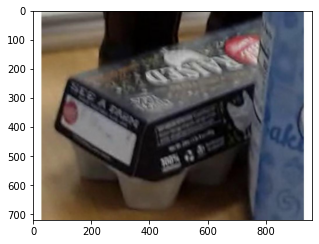

11111-Egg :   predicted as  5000015991-evaporatedMilk 0.654


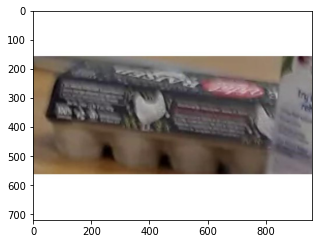

11111-Egg :   predicted as  7314115315-oreoPocky 0.6636


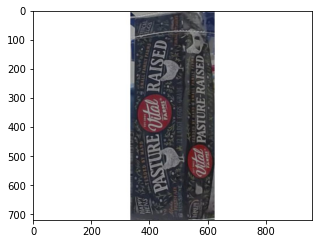

11111-Egg :   predicted as  6416410193-BlueBerryBun 0.2411


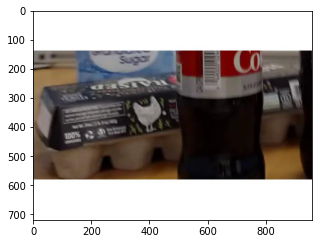

11111-Egg :   predicted as  5000015991-evaporatedMilk 0.607


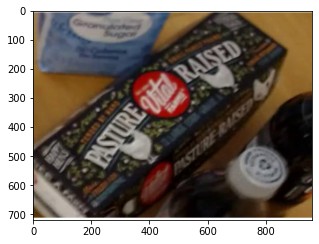

11111-Egg :   predicted as  5000015991-evaporatedMilk 0.8267


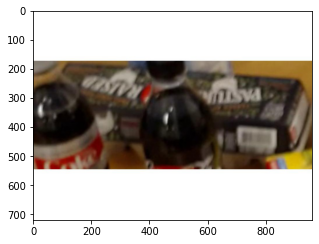

11111-Egg :   predicted as  5000015991-evaporatedMilk 0.4407


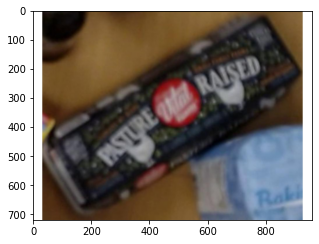

11111-Egg :   predicted as  5000015991-evaporatedMilk 0.7266


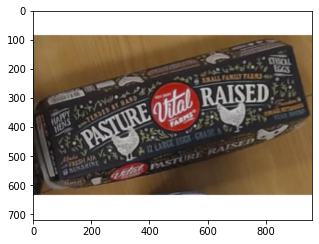

11111-Egg :   predicted as  11111-Egg 0.4058


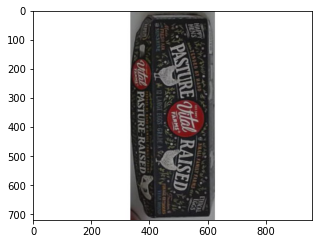

11111-Egg :   predicted as  7874212406-sweetner 0.337


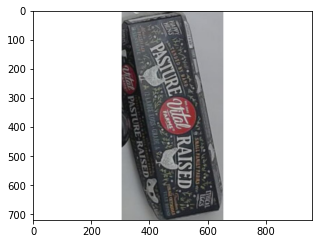

11111-Egg :   predicted as  800016643095-Chips 0.322


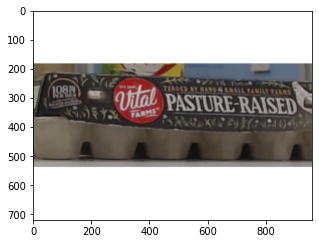

11111-Egg :   predicted as  11111-Egg 0.9663


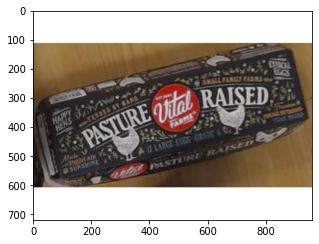

11111-Egg :   predicted as  11111-Egg 0.8306


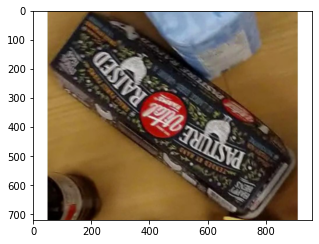

11111-Egg :   predicted as  4288742634-dishwasherCleaner 0.7847


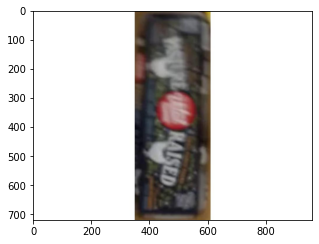

11111-Egg :   predicted as  7874212406-sweetner 0.3386


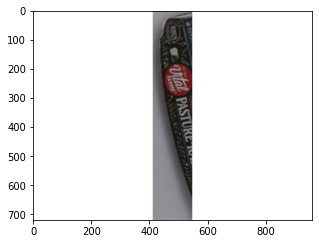

11111-Egg :   predicted as  7314115315-oreoPocky 0.424


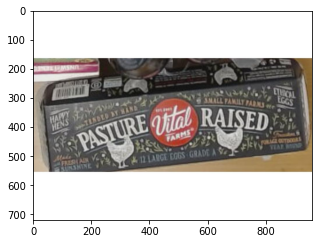

11111-Egg :   predicted as  11111-Egg 0.54


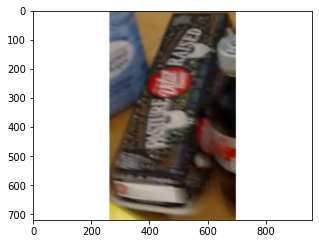

11111-Egg :   predicted as  5000015991-evaporatedMilk 0.529


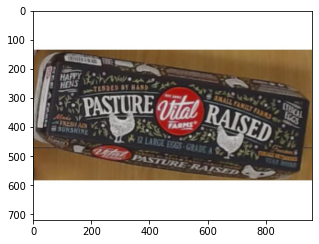

11111-Egg :   predicted as  11111-Egg 0.9526


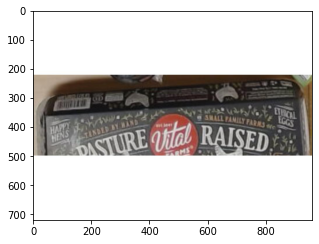

11111-Egg :   predicted as  1411391254-Pistachios 0.4443


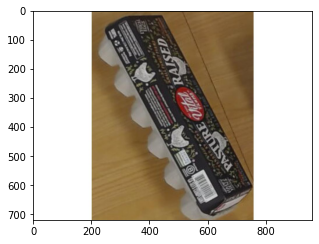

11111-Egg :   predicted as  7314115315-oreoPocky 0.6016

accuracy on class 11111-Egg is :0.16279069767441862

accuracy on all is : 0.17625899280575538


In [7]:
# Enroll new product{class:description}
product_descriptions = {"7874222803-sugar": "Great Value Pure Granulated Sugar 4 lb",
            "4157005670-almondmilk": "Blue Diamond Almond Breeze milk Unsweetened Original Almond Milk, Half Gallon, 64 fl oz",
            "8491201426-HoneyBunch": "Honey Bunches of Oats Honey Roasted Heart Healthy Low Fat made with Whole Grain Cereal, 18 ounce",
            "8113118392-tussin": "Equate Tussin Cough Syrup DM Cough Suppressant and Expectorant Wild Cherry Flavor 8 fl oz",
            "8113106123-tussin_max": "Equate Tussin DM Cough Cold Raspberry Menthrol Flavor, 4 fl Oz",
            "7874212406-sweetner": "great value no calorie sweenter 200 count 7 oz",
            "1015803449-Cleanser":"Polident Overnight Whitening Antibacterial Denture Cleanser Tablets,120 Count",
            "4400004575-RitzCracker": "Ritz Fresh Stacks Original Crackers Family Size, 17.8 Oz",
            "3600041777-Wipes": "Cottonelle Flushable Wet Wipes for Adults, 1 Refill Pack, 168 Flushable Wipes",
            "41331112406-Beans": "Goya Pink Beans 15.5 Oz",
            "1411391254-Pistachios":"Wonderful Pistachios No Shell Roasted & Salted 12 Oz",
            "8616220043-water":"smartwater nutrient-enhanced water bottle, 20 fl oz",
            "7203002209-littleBite":"Entenmann Little Bites Party Cake Muffin 5 Pouches per Box",
            "4000055113-m&mMilk":"M&M's Milk Chocolate Candy, Party size-38 oz Bag",
            "1800012323-miniBiscuits":"Pillsbury Chocolate Chip Mini Sweet Biscuits 7 pouches 28ct",
            "4000051121-m&mPeanut": "M&M's Peanut Milk Chocolate Candy, Family Size-19.2 oz Bag",
            "3528244925-toyPenguin": "Munchkin Wind Up Swimming Penguim Bath Toy, Color May Vary",
            "1920089962-SurfaceCleaner": "Lysol Clean & Fresh Multi-Surface Cleaner, Lemon & Sunflower, 48oz",
            "1600017819-berryCereal": "Franken Berry Breakfast Cereal, 16 oz Box",
            "5000015991-evaporatedMilk": "Nestle Carnation Lowfact 2% Evapotared Milk 12 fl oz",
            "7314115315-oreoPocky": "Glico Pocky Cookies and Cream Covered Biscuit Stickes, 1.41oz",
            "7232075003-pandaCookie": "Meiji Hello Panda Cookies Strawberry Creame, 2.1 Oz",
            "787423717-taco": "Great Value Taco Seasoning Mix 1.25 oz",
            "4300020056-limeJello": "Jell-O Lime Gelatin Dessert Mix, 6 oz Box",
            "4300020053-cherryJello": "Jell-O Cherry Gelatin Dessert Mix, 6 oz Box",
            "1370037299-Ziplock": "Hefty Slider Freezer Storage Bags, Quart Size, 25 Count",
            "4288742634-dishwasherCleaner": "Plink Appliance Cleaner, Best Brands",
            "000000-lemon":"Lemons each",
            "6416410193-BlueBerryBun": "Ozery Bakery Blueberry Snacking Rounds 10.6 Oz 12 Buns",
            "84576204143-galaApple": "Gala Apple 3lb Bag",
            "800016643095-Chips": "Jack'n Jill Chips Barbecue 3.88 Oz",
            "9413844-FujiApple": "Fuji Apples Bulk",
            "11111-Egg": "Vital Farms Pasture Raised Large Brown Grade A Eggs, 12 Count"}

print(list(product_descriptions.keys()))
print(list(product_descriptions.values()))

%matplotlib inline

import torch
import clip
from PIL import Image
import glob
import matplotlib.pyplot as plt

def argmax(iterable):
    return max(enumerate(iterable), key=lambda x: x[1])[0]

device = "cuda" if torch.cuda.is_available() else "cpu"
model, transform = clip.load("ViT-B/32", device=device)

correct = []

#define our target classificaitons, you can should experiment with these strings of text as you see fit, though, make sure they are in the same order as your class names above
class_names = list(product_descriptions.keys())
candidate_captions = list(product_descriptions.values())
text = clip.tokenize(candidate_captions).to(device)
y_true = []
y_pred = []
for cls in class_names:
    class_correct = []
    test_imgs = glob.glob('./roboflowIsoObj_Clip/train/' + cls + '/*.jpg')

    for img in test_imgs:
        image = transform(Image.open(img)).unsqueeze(0).to(device)
        with torch.no_grad():
            image_features = model.encode_image(image)
            text_features = model.encode_text(text)

            logits_per_image, logits_per_text = model(image, text)
            probs = logits_per_image.softmax(dim=-1).cpu().numpy()

            pred = class_names[argmax(list(probs)[0])]
            im = Image.open(img)
            plt.figure(figsize=(5,5))
            plt.imshow(im)
            plt.show()

            print(cls, ": "," predicted as ", pred, max(list(probs)[0]) )
            if pred == cls:
                correct.append(1)
                class_correct.append(1)
            else:
                correct.append(0)
                class_correct.append(0)
            y_true.append(cls)
            y_pred.append(pred)
    
    if len(class_correct) !=0:
        print('\naccuracy on class ' + cls + ' is :' + str(sum(class_correct)/len(class_correct)))
    else: 
        print('\nno picture are found for ' + cls)
print('\naccuracy on all is : ' + str(sum(correct)/len(correct)))


In [ ]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
cm = confusion_matrix(y_true, y_pred, labels = class_names)

disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues)
plt.show()

In [ ]:
len(class_correct)

# Run with Realsense D435i Streaming

### 1. Tried custom text embedding

In [ ]:
# Check available model
clip.available_models()

### 2. Tried Walmart product name from catalogue item file for text embebdding

In [ ]:
import pyrealsense2 as rs
import cv2
import numpy as np
import torch
import clip
from PIL import Image

# upload a clip model

device = "cuda" if torch.cuda.is_available() else "cpu"
model, transform = clip.load("ViT-B/32", device=device)

# Enroll new product {upc: walmart product name}
product_descriptions = {"7874222803-sugar": "Great Value Pure Granulated Sugar 4 lb",
            "4157005670-almondmilk": "Blue Diamond Almond Breeze milk Unsweetened Original Almond Milk, Half Gallon, 64 fl oz",
            "8491201426-HoneyBunch": "Honey Bunches of Oats Honey Roasted Heart Healthy Low Fat made with Whole Grain Cereal, 18 ounce",
            "8113118392-tussin": "Equate Tussin Cough Syrup DM Cough Suppressant and Expectorant Wild Cherry Flavor 8 fl oz",
            "8113106123-tussin_max": "Equate Tussin DM Cough Cold Raspberry Menthrol Flavor, 4 fl Oz",
            "7874212406-sweetner": "great value no calorie sweenter 200 count 7 oz",
            "1015803449-Cleanser":"Polident Overnight Whitening Antibacterial Denture Cleanser Tablets,120 Count",
            "4400004575-RitzCracker": "Ritz Fresh Stacks Original Crackers Family Size, 17.8 Oz",
            "3600041777-Wipes": "Cottonelle Flushable Wet Wipes for Adults, 1 Refill Pack, 168 Flushable Wipes",
            "41331112406-Beans": "Goya Pink Beans 15.5 Oz",
            "1411391254-Pistachios":"Wonderful Pistachios No Shell Roasted & Salted 12 Oz",
            "8616220043-water":"smartwater nutrient-enhanced water bottle, 20 fl oz",
            "7203002209-littleBite":"Entenmann Little Bites Party Cake Muffin 5 Pouches per Box",
            "4000055113-m&mmilkchocolate":"M&M's Milk Chocolate Candy, Party size-38 oz Bag",
            "1800012323-miniBiscuits":"Pillsbury Chocolate Chip Mini Sweet Biscuits 7 pouches 28ct",
            "4000051121-m&mPeanutChoco": "M&M's Peanut Milk Chocolate Candy, Family Size-19.2 oz Bag",
            "3528244925-toyPenguin": "Munchkin Wind Up Swimming Penguim Bath Toy, Color May Vary",
            "1920089962-SurfaceCleaner": "Lysol Clean & Fresh Multi-Surface Cleaner, Lemon & Sunflower, 48oz",
            "1600017819-berryCereal": "Franken Berry Breakfast Cereal, 16 oz Box",
            "5000015991-evaporatedMilk": "Nestle Carnation Lowfact 2% Evapotared Milk 12 fl oz",
            "7314115315-oreoPocky": "Glico Pocky Cookies and Cream Covered Biscuit Stickes, 1.41oz",
            "7232075003-pandaCookie": "Meiji Hello Panda Cookies Strawberry Creame, 2.1 Oz",
            "787423717-taco": "Great Value Taco Seasoning Mix 1.25 oz",
            "4300020056-limeJello": "Jell-O Lime Gelatin Dessert Mix, 6 oz Box",
            "4300020053-cherryJello": "Jell-O Cherry Gelatin Dessert Mix, 6 oz Box",
            "1370037299-Ziplock": "Hefty Slider Freezer Storage Bags, Quart Size, 25 Count",
            "4288742634-dishwasherCleaner": "Plink Appliance Cleaner, Best Brands",
            "000000-lemon":"Lemons each",
            "6416410193-BlueBerryBun": "Ozery Bakery Blueberry Snacking Rounds 10.6 Oz 12 Buns",
            "84576204143-galaApple": "Gala Apple 3lb Bag",
            "800016643095-Chips": "Jack'n Jill Chips Barbecue 3.88 Oz",
            "9413844-FujiApple": "Fuji Apples Bulk"}




#define our target classificaitons
class_names = list(product_descriptions.keys())
candidate_captions = list(product_descriptions.values())
text = clip.tokenize(candidate_captions).to(device)


def argmax(iterable):
    return max(enumerate(iterable), key=lambda x: x[1])[0]

try:
    pipeline = rs.pipeline()
    config = rs.config()
    config.enable_stream(rs.stream.color, 640,480, rs.format.bgr8, 30)
    pipeline.start(config)
    
    while True:
        frames = pipeline.wait_for_frames()    
        color_image = np.asarray(frames.get_color_frame().get_data())
        
        img = Image.fromarray(color_image)

        image = transform(img).unsqueeze(0).to(device)   # transform takes PIL image only - See clip.py

        with torch.no_grad():
            image_features = model.encode_image(image)
            text_features = model.encode_text(text)
            
            logits_per_image, logits_per_text = model(image, text)
            probs = logits_per_image.softmax(dim=-1).cpu().numpy()

            pred = class_names[argmax(list(probs)[0])]
            prob = max(list(probs)[0])
            if prob > 0.60:
                class_str = pred + ' ' + str(prob)
            else:
                class_str = "Not recognized"
            
        cv2.namedWindow("Classifier", cv2.WINDOW_NORMAL)
        cv2.resizeWindow("Classifier", 1280, 960)
        cv2.putText(color_image, class_str, (10,25),cv2.FONT_HERSHEY_SIMPLEX,1, (0,0,255),2)

        cv2.imshow("Classifier",color_image)
        cv2.waitKey(1)
    exit(0)
except Exception as e:
    print(e)
    pass